In [1]:
import pandas as pd
import json
import numpy as np
import matplotlib.pyplot as plt
import cv2
from datetime import datetime
import os
from tqdm import tqdm, notebook
import albumentations as A

import torch
import torch.nn as nn
import torchvision
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import transforms
from torch.nn.functional import relu
import torch.nn.functional as F
import torch.optim as optim
from torchinfo import summary

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', 999)

device=torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Dataloading

In [2]:
class HubMap_Dataset(Dataset):
    def __init__(self, img_path, labels_file, metadata_file, augmentation=None):
        self.image_dir = img_path
        self.labels_file = labels_file
        self.metadata_file = metadata_file
        self.augmentation = augmentation

        # Processing JSON data to create a pandas df        
        with open(labels_file) as json_file:
            json_list = list(json_file)

        dataset = []
        for json_str in notebook.tqdm(json_list, desc="Reading Json Data"):
            result = json.loads(json_str)

            annotations = result['annotations']                        
            for ann in annotations:
                row = {
                    "id": result["id"],
                    "type": ann["type"],
                    "coordinates": ann["coordinates"]
                }
                if ann["type"] == "blood_vessel":
                    row["mask"] = self.coordinates_to_masks(ann["coordinates"], (512, 512), 1)[0]
                elif ann["type"] == "glomerulus":
                    row["mask"] = self.coordinates_to_masks(ann["coordinates"], (512, 512), 2)[0]
                elif ann["type"] == "unsure":
                    row["mask"] = self.coordinates_to_masks(ann["coordinates"], (512, 512), 3)[0]
                dataset.append(row)
        
        self.dataset = pd.DataFrame(dataset, columns=["id", "type", "coordinates", "mask"])

    def coordinates_to_masks(self, coordinates, shape, class_num):
        masks = []
        for coord in coordinates:
            mask = np.zeros(shape, dtype=np.uint8)
            cv2.fillPoly(mask, [np.array(coord)], class_num)
            masks.append(mask)
        return masks

    def __len__(self):
        return len(self.dataset['id'].unique())

    def __getitem__(self, idx):
        unique_ids = self.dataset['id'].unique()
        img_id = unique_ids[idx]
        image_path = f"{self.image_dir}/{img_id}.tif"
        image = cv2.imread(image_path, cv2.COLOR_BGR2RGB) # cv2 reads in h,w,c
        
        # Create a combined mask containing all classes for each ID
        all_filled_masks = np.zeros((512, 512, 1), dtype=np.uint8)
        annotations = self.dataset[self.dataset['id'] == img_id]
        for _, row in annotations.iterrows():
            coordinates = np.array(row["coordinates"])
            class_num = 1 if row["type"] == "blood_vessel" else 2 if row["type"] == "glomerulus" else 3
            all_filled_masks = cv2.fillPoly(all_filled_masks, [coordinates], class_num)
                
        # Augment data
        if self.augmentation is not None:
            augmented = self.augmentation(image=image, mask=all_filled_masks)
            image, masks = augmented['image'], augmented['mask']

        masks = torch.tensor(masks, dtype=torch.int64).permute(2, 0, 1)
        image = np.array(image) / 255.0
        image = torch.tensor(image, dtype=torch.float32).permute(2, 0, 1) # c,h,w
        
        return image, masks, img_id


In [3]:
base_path = "/kaggle/input/hubmap-hacking-the-human-vasculature/"
images_folder = base_path + "/train/"
labels_path = base_path + "/polygons.jsonl"
metadata_path = base_path + "/tile_meta.csv"

augs = A.Compose([
    A.HorizontalFlip(p=0.3),
    A.VerticalFlip(p=0.3),
    A.RandomRotate90(p=0.3),
    A.OneOf([
        A.PiecewiseAffine(scale=(0.01, 0.05), p=1),
        A.GaussianBlur(blur_limit=(3, 3), p=1),
    ], p=0.5),
    A.OneOf([
        A.HueSaturationValue(hue_shift_limit=10, sat_shift_limit=10, val_shift_limit=10, p=1),
        A.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1),
        A.CLAHE(clip_limit=2.0, p=1), # equalize colors based on histogram
    ], p=0.5),
])

HMD = HubMap_Dataset(img_path=images_folder, labels_file=labels_path, metadata_file=metadata_path, augmentation=augs)
val_len = int(0.2*len(HMD))
lengths = [len(HMD)-val_len, val_len]
train_set, val_set = torch.utils.data.random_split(HMD, lengths)
print(f"train set: {len(train_set)}, validation set: {len(val_set)}")

Reading Json Data:   0%|          | 0/1633 [00:00<?, ?it/s]

train set: 1307, validation set: 326


In [4]:
def calculate_class_weights(samples):
    # 1. Count pixels per class
    count_dict = {"bg": 0, "bv": 0, "gl": 0, "us": 0}
    cls_dict = {"bg": 0, "bv": 1, "gl": 2, "us": 3}
    start = datetime.now()

    for s in samples:
        img, msk, ids = s
        cls_vals, cls_count = np.unique(msk.numpy().flatten(), return_counts=True)

        for val, count in zip(cls_vals, cls_count):
            for cl, idx in cls_dict.items():
                if val == idx:
                    count_dict[cl] += count
    
    # 2. Inverse class ratio
    cs_listed = list(count_dict.values())
    class_ratio = [count / sum(cs_listed) for count in cs_listed]
    inv_class_ratio = [1.0 / ratio if ratio > 0 else 0.0 for ratio in class_ratio]

    # 3. Normalize weights
    class_weights = [ratio / sum(inv_class_ratio) * len(cs_listed) for ratio in inv_class_ratio]

    end = datetime.now() - start
    print(f"Class ratio: {class_ratio}")
    print(f"Inverse class ratio: {inv_class_ratio}")
    print(f"Normalized class weights: {class_weights}")
    print(f"\nFunction time (hh:mm:ss:ms): {end}")

    return class_weights

# (Takes 1:27 sec) but for simplicity saved the output (in order: bg, bl, gl, us)
# class_weights = calculate_class_weights(HMD)
class_weights = [0.017368886725679104, 0.3511634395617824, 0.3857616978370867, 3.245705975875452]

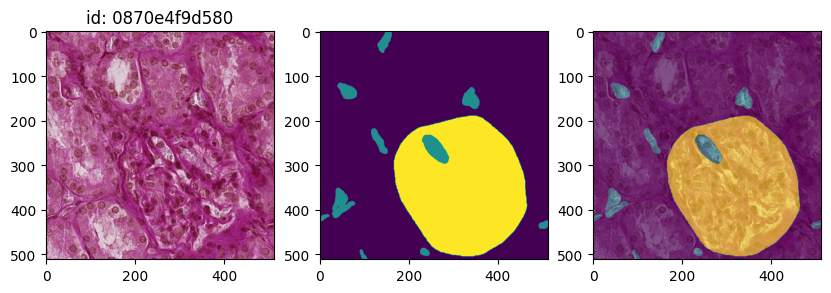

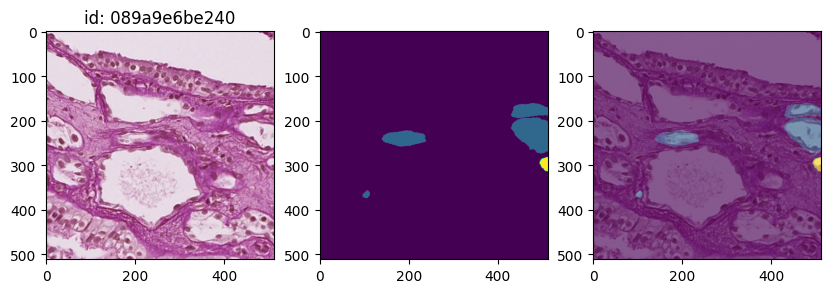

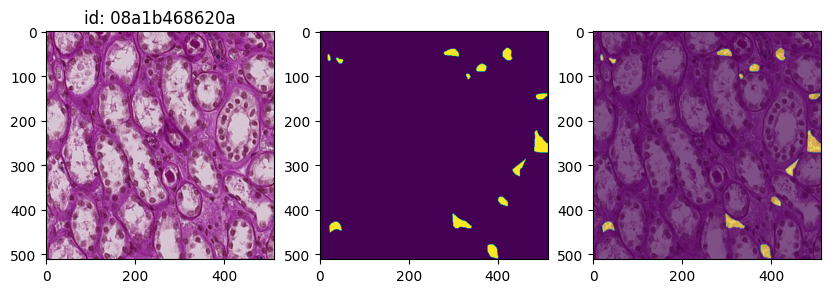

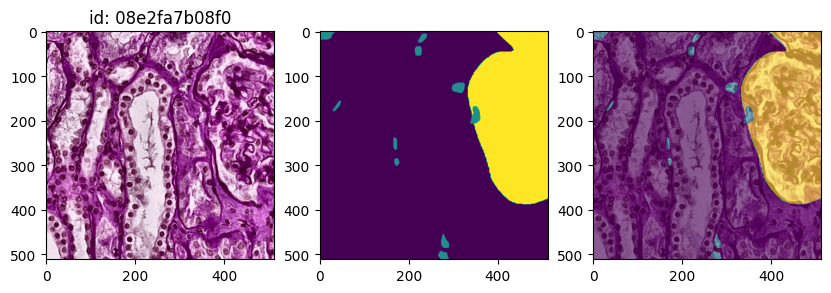

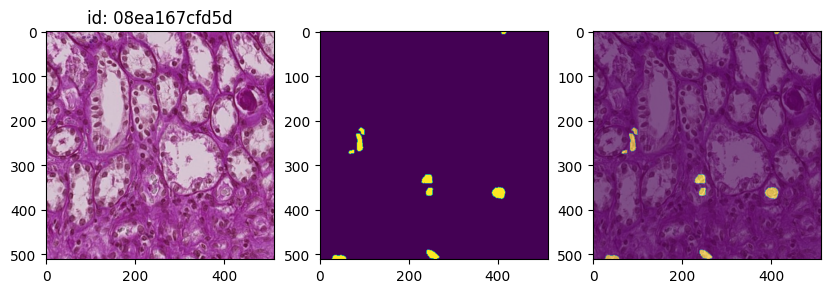

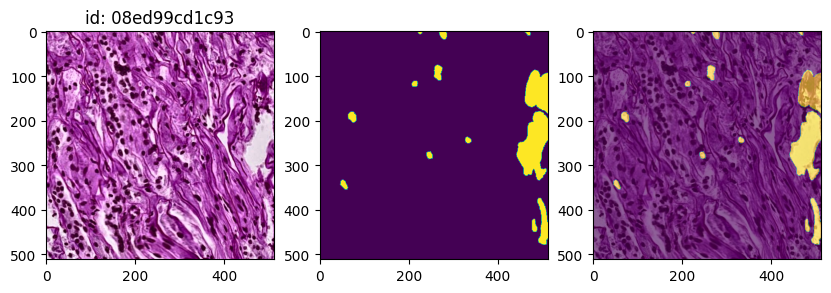

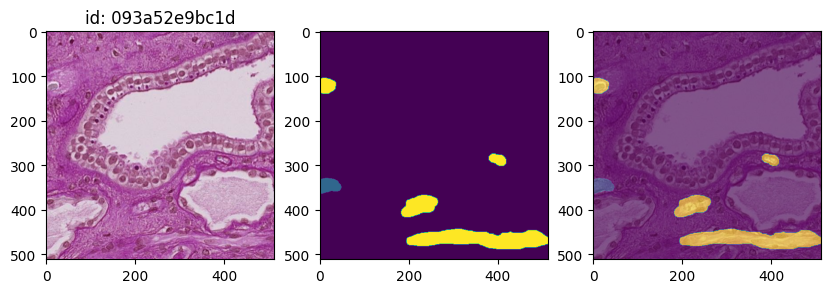

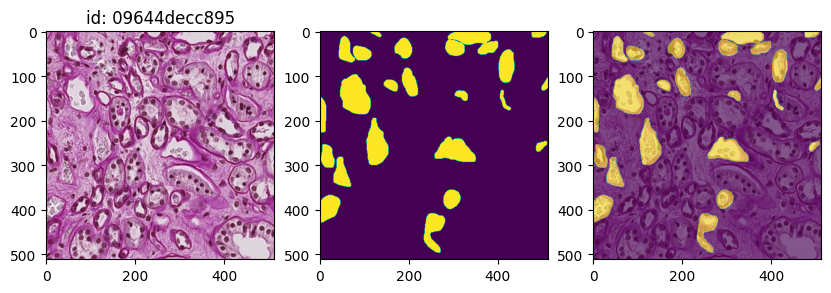

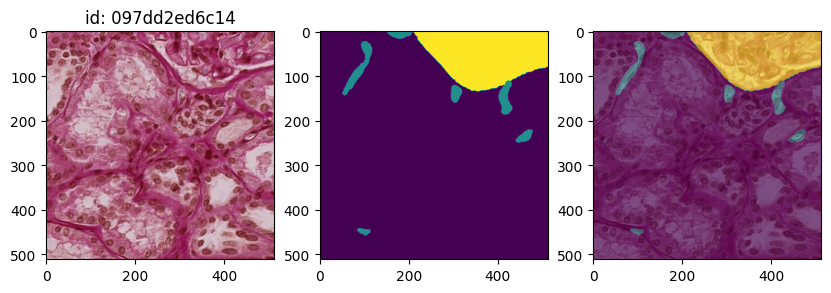

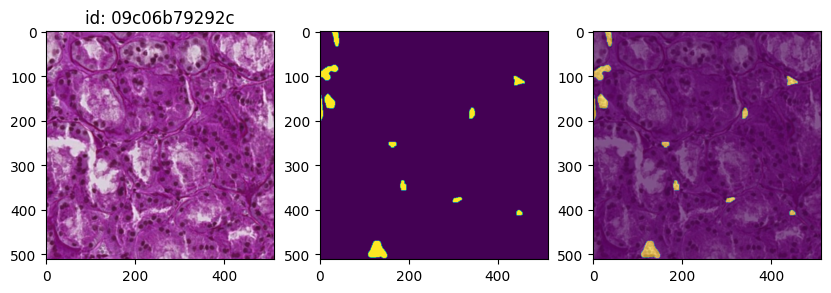

In [5]:
# Visualize samples
samples = [HMD[i] for i in range(50,60)]

for sample in samples:
    masks = sample[1].squeeze(0)
    image = sample[0].permute(1,2,0).numpy()

    fig, axs = plt.subplots(1,3,figsize=(10,8))
    axs[0].imshow(image)    
    axs[0].set_title(f"id: {sample[2]}")
    axs[1].imshow(masks)
    axs[2].imshow(image)
    axs[2].imshow(masks, alpha=0.6)
    plt.show()

## UNet model

For better feature maps I added plus 1 level to the Unet, so that the bottom level produces 16x16 feature maps.
As experiment the number of conv-bn-relu block or the filter size can be increased.

In [6]:
# # default might be better(uniform), but test it
# def init_weights(m):
#     if isinstance(m, nn.Conv2d):
#         torch.nn.init.kaiming_uniform_(m.weight, nonlinearity="relu")
#         m.bias.data.fill_(0.01)

# class ConvBlock(nn.Module):
#     def __init__(self, in_channels, out_channels):
#         super().__init__()
#         self.conv = nn.Sequential(
#             nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
#             nn.BatchNorm2d(out_channels),
#             nn.ReLU(inplace=True),
            
#             nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
#             nn.BatchNorm2d(out_channels),
#             nn.ReLU(inplace=True),
#             nn.Dropout(0.1),
#         )

#     def forward(self, x):
#         return self.conv(x)

# class UNet(nn.Module):
#     def __init__(self, in_channels=3, in_filters=32, num_classes=4):
#         super().__init__()

#         self.num_classes = num_classes

#         # Donwsample
#         self.encoder1 = ConvBlock(in_channels, in_filters)
#         self.pool1 = nn.MaxPool2d(2)
#         self.encoder2 = ConvBlock(in_filters, in_filters * 2)
#         self.pool2 = nn.MaxPool2d(2)
#         self.encoder3 = ConvBlock(in_filters * 2, in_filters * 4)
#         self.pool3 = nn.MaxPool2d(2)
#         self.encoder4 = ConvBlock(in_filters * 4, in_filters * 8)
#         self.pool4 = nn.MaxPool2d(2)

#         # Bottom layer
#         self.bottleneck = ConvBlock(in_filters * 8, in_filters * 16)

#         # Upsample
#         self.upconv4 = nn.ConvTranspose2d(in_filters * 16, in_filters * 8, 2, stride=2, output_padding=0)
#         self.decoder4 = ConvBlock(in_filters * 16, in_filters * 8)
#         self.upconv3 = nn.ConvTranspose2d(in_filters * 8, in_filters * 4, 2, stride=2)
#         self.decoder3 = ConvBlock(in_filters * 8, in_filters * 4)
#         self.upconv2 = nn.ConvTranspose2d(in_filters * 4, in_filters * 2, 2, stride=2)
#         self.decoder2 = ConvBlock(in_filters * 4, in_filters * 2)
#         self.upconv1 = nn.ConvTranspose2d(in_filters * 2, in_filters, 2, stride=2)
#         self.decoder1 = ConvBlock(in_filters * 2, in_filters)

#         # Classifier
#         self.conv = nn.Conv2d(in_filters, num_classes, 1)
#         self.apply(init_weights)

#     def forward(self, x):
#         enc1 = self.encoder1(x)
#         pool1 = self.pool1(enc1)
#         enc2 = self.encoder2(pool1)
#         pool2 = self.pool2(enc2)
#         enc3 = self.encoder3(pool2)
#         pool3 = self.pool3(enc3)
#         enc4 = self.encoder4(pool3)
#         pool4 = self.pool4(enc4)

#         bottleneck = self.bottleneck(pool4)

#         upconv4 = self.upconv4(bottleneck)
#         cat4 = torch.cat([upconv4, enc4], dim=1)
#         dec4 = self.decoder4(cat4)
#         upconv3 = self.upconv3(dec4)
#         cat3 = torch.cat([upconv3, enc3], dim=1)
#         dec3 = self.decoder3(cat3)
#         upconv2 = self.upconv2(dec3)
#         cat2 = torch.cat([upconv2, enc2], dim=1)
#         dec2 = self.decoder2(cat2)
#         upconv1 = self.upconv1(dec2)
#         cat1 = torch.cat([upconv1, enc1], dim=1)
#         dec1 = self.decoder1(cat1)

#         return self.conv(dec1)

In [17]:
# # default might be better(uniform), but test it
def init_weights(m):
    if isinstance(m, nn.Conv2d):
        torch.nn.init.kaiming_uniform_(m.weight, nonlinearity='relu')
        if m.bias is not None:
            m.bias.data.fill_(0.01)

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        return self.conv(x)

class UNet(nn.Module):
    def __init__(self, in_channels=3, in_filters=32, num_classes=4):
        super().__init__()

        self.num_classes = num_classes
        
        # Donwsample
        self.encoder1 = ConvBlock(in_channels, in_filters)
        self.pool1 = nn.MaxPool2d(2)
        self.encoder2 = ConvBlock(in_filters, in_filters*2)
        self.pool2 = nn.MaxPool2d(2)
        self.encoder3 = ConvBlock(in_filters*2, in_filters*4)
        self.pool3 = nn.MaxPool2d(2)
        self.encoder4 = ConvBlock(in_filters*4, in_filters*8)
        self.pool4 = nn.MaxPool2d(2)
        self.encoder5 = ConvBlock(in_filters*8, in_filters*16)
        self.pool5 = nn.MaxPool2d(2)

        # Bottom layer
        self.bottleneck = ConvBlock(in_filters*16, in_filters*32)

        # Upsample
        self.upconv5 = nn.ConvTranspose2d(in_filters*32, in_filters*16, 2, stride=2, output_padding=0,)
        self.decoder5 = ConvBlock(in_filters*32, in_filters*16)
        self.upconv4 = nn.ConvTranspose2d(in_filters*16, in_filters*8, 2, stride=2)
        self.decoder4 = ConvBlock(in_filters*16, in_filters*8)
        self.upconv3 = nn.ConvTranspose2d(in_filters*8, in_filters*4, 2, stride=2)
        self.decoder3 = ConvBlock(in_filters*8, in_filters*4)
        self.upconv2 = nn.ConvTranspose2d(in_filters*4, in_filters*2, 2, stride=2)
        self.decoder2 = ConvBlock(in_filters*4, in_filters*2)
        self.upconv1 = nn.ConvTranspose2d(in_filters*2, in_filters, 2, stride=2)
        self.decoder1 = ConvBlock(in_filters*2, in_filters)
            
        # Classifier
        self.conv = nn.Conv2d(in_filters, num_classes, 1)
        self.apply(init_weights)
        
    def forward(self, x):
        enc1 = self.encoder1(x)
        pool1 = self.pool1(enc1)
        enc2 = self.encoder2(pool1)
        pool2 = self.pool2(enc2)
        enc3 = self.encoder3(pool2)
        pool3 = self.pool3(enc3)
        enc4 = self.encoder4(pool3)
        pool4 = self.pool4(enc4)
        enc5 = self.encoder5(pool4)
        pool5 = self.pool5(enc5)
        
        bottleneck = self.bottleneck(pool5)

        upconv5 = self.upconv5(bottleneck)
        cat5 = torch.cat([upconv5, enc5], dim=1)
        dec5 = self.decoder5(cat5)
        upconv4 = self.upconv4(dec5)
        cat4 = torch.cat([upconv4, enc4], dim=1)
        dec4 = self.decoder4(cat4)
        upconv3 = self.upconv3(dec4)
        cat3 = torch.cat([upconv3, enc3], dim=1)
        dec3 = self.decoder3(cat3)
        upconv2 = self.upconv2(dec3)
        cat2 = torch.cat([upconv2, enc2], dim=1)
        dec2 = self.decoder2(cat2)
        upconv1 = self.upconv1(dec2)
        cat1 = torch.cat([upconv1, enc1], dim=1)
        dec1 = self.decoder1(cat1)
        
        return self.conv(dec1)

In [18]:
## setup config
class cfg:
    img_size = 512
    in_ch = 3
    num_classes = 4 # cls + bg
    filters = 16
    mixed_precision = True
    h_params = {"epochs": 100,
                "batch_size": 16,
                "weight_decay": 1e-4,
                "init_lr": 1e-3,
                "early_stopping": 5,
                "lr_patience": 1,
                "lr_factor": 0.2,
                "t_max": 8,
                "eta_min": 1e-6,
               }

# Create Unet
unet_model = UNet(in_filters=cfg.filters, num_classes=cfg.num_classes)
unet_model.to(device)

summary(unet_model, input_size=(1,3,512,512), col_names=['input_size','output_size','num_params','trainable'])

Layer (type:depth-idx)                   Input Shape               Output Shape              Param #                   Trainable
UNet                                     [1, 3, 512, 512]          [1, 4, 512, 512]          --                        True
├─ConvBlock: 1-1                         [1, 3, 512, 512]          [1, 16, 512, 512]         --                        True
│    └─Sequential: 2-1                   [1, 3, 512, 512]          [1, 16, 512, 512]         --                        True
│    │    └─Conv2d: 3-1                  [1, 3, 512, 512]          [1, 16, 512, 512]         448                       True
│    │    └─BatchNorm2d: 3-2             [1, 16, 512, 512]         [1, 16, 512, 512]         32                        True
│    │    └─ReLU: 3-3                    [1, 16, 512, 512]         [1, 16, 512, 512]         --                        --
│    │    └─Conv2d: 3-4                  [1, 16, 512, 512]         [1, 16, 512, 512]         2,320                     True
│    

## Training

In [19]:
train_loader = DataLoader(train_set, batch_size=cfg.h_params['batch_size'], shuffle=True)
val_loader = DataLoader(val_set, batch_size=cfg.h_params['batch_size'], shuffle=True)
oneb = next(iter(train_loader))
ims, lbs, ids = oneb
print(f"images: {ims.shape, ims.dtype, ims.device}\nmasks: {lbs.shape, lbs.dtype, lbs.device}")

images: (torch.Size([16, 3, 512, 512]), torch.float32, device(type='cpu'))
masks: (torch.Size([16, 1, 512, 512]), torch.int64, device(type='cpu'))


In [20]:
seg_class_idx = {
    "blood_vessel": 1,
    "glomerulus": 2,
    "unsure": 3,
}

def dice_score(pred_class_i, labels_i):
    dice = (2 * (pred_class_i * labels_i).sum().item()) / ((pred_class_i + labels_i).sum().item() + 1e-8)
    return dice

def calc_stats(labels, preds):
    pixel_acc = {}
    dice_scores = {}
    ious = {}
    
    pred_class = torch.argmax(preds, dim=1)
    
    for class_name, class_id in seg_class_idx.items():
        pred_class_i = (pred_class == class_id).to(torch.uint8)
        labels_i = (labels == class_id).to(torch.uint8)

        num_correct = (pred_class_i == labels_i).sum().item()
        num_pixels = labels_i.numel()
        intersection = (pred_class_i * labels_i).sum().item()
        union = (pred_class_i + labels_i).sum().item() - intersection

        if union > 0:
            pixel_acc[class_name] = num_correct / num_pixels * 100
            ious[class_name] = intersection / union * 100
            dice_scores[class_name] = dice_score(pred_class_i, labels_i)
        else:
            pixel_acc[class_name] = 0
            ious[class_name] = 0        
            dice_scores[class_name] = 0

    return dice_scores, ious, pixel_acc


def model_trainer(train_loader, valid_loader, model, loss_fn, optimizer, scheduler, epochs, early_stop_patience, set_scaler=False, device="cuda"):

    torch.cuda.empty_cache()
    scaler = torch.cuda.amp.GradScaler() if set_scaler else None
    early_stopping_counter = 0
    prev_val_loss = np.Inf
    history = {
        "epoch": [],
        "train_loss": [],
        "valid_loss": [],
        "p_acc": [],
        "d_score": [],
        "iou": [],
        "blood_vessel": { "p_acc":[], "d_score":[], "iou":[],},
        "glomerulus": { "p_acc":[], "d_score":[], "iou":[],},
        "unsure": { "p_acc":[], "d_score":[], "iou":[],},
    }

    start = datetime.now()
    for e in range(epochs):

        # TRAINING
        model.train()
        print("-" * 40)
        print(f"EPOCH {e + 1}. training step...")
        train_time_1 = datetime.now()
        loss_list = []

        for i, data in enumerate(train_loader):
            im = data[0].to(device)
            seg_gt = data[1].squeeze(1).to(device)

            with torch.cuda.amp.autocast(enabled=set_scaler):
                seg_pred = model.forward(im)
                loss = loss_fn(seg_pred, seg_gt)

            # Backward and optimize
            optimizer.zero_grad()
            if set_scaler:
                scaler.scale(loss.mean()).backward()
                scaler.step(optimizer)
                scaler.update()
            else:
                loss.backward()
                optimizer.step()

            # Collect loss
            loss_list.append(loss.item())
        train_time_2 = datetime.now()- train_time_1
        print(f" - epoch training time: (hh:mm:ss:ms): {train_time_2}\n")

        # VALIDATION
        model.eval()
        print(f"EPOCH {e + 1}. validation step...")
        val_loss_list = []
        all_dice_scores = {class_name: 0 for class_name in seg_class_idx.keys()}
        all_iou = {class_name: 0 for class_name in seg_class_idx.keys()}
        all_pixel_acc = {class_name: 0 for class_name in seg_class_idx.keys()}
            
        for i, data in enumerate(valid_loader):
            im = data[0].to(device)
            seg_gt = data[1].squeeze(1).to(device)

            with torch.no_grad():
                seg_pred = model.forward(im)
                val_loss = loss_fn(seg_pred, seg_gt)
                val_loss_list.append(val_loss.item())

                ## Stats calculation
                batch_dice_scores, batch_iou, batch_pixel_acc = calc_stats(labels=seg_gt, preds=seg_pred)
                
                for class_name in seg_class_idx.keys():
                    all_dice_scores[class_name] += batch_dice_scores[class_name]
                    all_iou[class_name] += batch_iou[class_name]
                    all_pixel_acc[class_name] += batch_pixel_acc[class_name]
                
        #  Take the avg of the collected losses
        avg_train_loss = np.mean(loss_list)
        avg_valid_loss = np.mean(val_loss_list)
        
        # Print out stats
        for class_name in seg_class_idx.keys():
            all_dice_scores[class_name] /= len(valid_loader)
            all_iou[class_name] /= len(valid_loader)
            all_pixel_acc[class_name] /= len(valid_loader)
        
        overall_dice_score = sum(all_dice_scores.values()) / len(seg_class_idx)
        overall_iou = sum(all_iou.values()) / len(seg_class_idx)
        overall_pixel_acc = sum(all_pixel_acc.values()) / len(seg_class_idx)
        
        print(f"Results:")
        print(f" - Train epoch mean loss: {avg_train_loss:.4f}")
        print(f" - Valid epoch mean loss: {avg_valid_loss:.4f}\n")
        print("Metrics by class:")
        for class_name in seg_class_idx.keys():
            print(f"   - '{class_name}' dice score: {all_dice_scores[class_name]:.4f}, iou: {all_iou[class_name]:.2f}%, pixel acc.: {all_pixel_acc[class_name]:.2f}%")
        
        print(f"\n - Overall dice score: {overall_dice_score:.4f}")
        print(f" - Overall iou: {overall_iou:.2f}%")
        print(f" - Overall pixel accuracy: {overall_pixel_acc:.2f}%")
        
        history["epoch"].append(e + 1)
        history["train_loss"].append(avg_train_loss)
        history["valid_loss"].append(avg_valid_loss)
        history["p_acc"].append(overall_pixel_acc)
        history["d_score"].append(overall_dice_score)
        history["iou"].append(overall_iou)
        for class_name in seg_class_idx.keys():
            history[class_name]["p_acc"].append(all_pixel_acc[class_name])
            history[class_name]["d_score"].append(all_dice_scores[class_name])
            history[class_name]["iou"].append(all_iou[class_name])
            
        # Compare losses, early stop when triggered
        if avg_valid_loss <= prev_val_loss:
            print(f" - Lower validation loss achieved ({prev_val_loss:.4f}-->{avg_valid_loss:.4f}). Saving model...")
            best_model_state = model.state_dict()
            torch.save(best_model_state, f'./best_model_state.h5')
            prev_val_loss = avg_valid_loss
            early_stopping_counter = 0
        else:
            early_stopping_counter += 1
            print(f" - Validation loss did not improve. Early stopping counter: {early_stopping_counter}/{early_stop_patience}")

            if early_stopping_counter >= early_stop_patience:
                break

        # Update LR
        if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
            scheduler.step(avg_valid_loss)
        else:
            scheduler.step()
        print(f" - LR for next epoch: {optimizer.param_groups[0]['lr']}\n")

    time_elapsed = datetime.now() - start
    print(f"\nFinished training. (hh:mm:ss:ms): {time_elapsed}\n")

    return history, best_model_state


In [21]:
class DiceCELoss(nn.Module):
    """ Combined loss function, utilizing CE and Dice losses. """

    def __init__(self, weight=None, smooth=1e-8):
        super().__init__()
        self.weight = weight
        self.smooth = smooth

    def forward(self, outputs, targets):
        ce_loss = F.cross_entropy(outputs, targets, weight=self.weight)
        targets = targets.to(device)

        # Calculate Dice Loss
        probs = F.softmax(outputs, dim=1)
        num_classes = outputs.shape[1]
        true_1_hot = torch.eye(num_classes).to(device)
        true_1_hot = true_1_hot[targets.squeeze(1)]
        true_1_hot = true_1_hot.permute(0, 3, 1, 2).float()

        intersection = torch.sum(probs * true_1_hot, dim=(2, 3))
        union = torch.sum(probs, dim=(2, 3)) + torch.sum(true_1_hot, dim=(2, 3))
        dice_loss = (2.0 * intersection + self.smooth) / (union + self.smooth)
        dice_loss = 1 - dice_loss.mean()

        # Combine Dice Loss and Crossentropy Loss
        combined_loss = ce_loss + dice_loss
        return combined_loss

In [22]:
## CLS WEIGHTS
# class_weights_tensor = torch.tensor([0.01, 1.2, 1.4, 14.0]).to(device) # order: bg,bv,gl,us
class_weights_tensor = torch.tensor(class_weights, dtype=torch.float32).to(device)
print(f'Class weights: {class_weights_tensor}')

## LOSS FNS
# loss_fn = torch.nn.CrossEntropyLoss(weight=class_weights_tensor)
loss_fn = DiceCELoss(weight=None)

## OPTIMIZERS
optimizer = torch.optim.AdamW(unet_model.parameters(), lr=cfg.h_params['init_lr'], weight_decay=cfg.h_params['weight_decay'])
# optimizer = torch.optim.Adam(unet_model.parameters(), lr=cfg.h_params['init_lr'])
# optimizer = torch.optim.SGD(unet_model.parameters(), lr=cfg.h_params['init_lr'])

## SCHEDULERS
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    patience=cfg.h_params['lr_patience'],
    factor=cfg.h_params['lr_factor'],
    min_lr=cfg.h_params['eta_min'],
)
# scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(
#     optimizer,
#     T_max=cfg.h_params['t_max'],
#     eta_min=cfg.h_params['eta_min'],
# )
# scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
#     optimizer,
#     T_0=4,
#     T_mult=2,
#     eta_min=cfg.h_params['eta_min'],
# )

model_hist, best_model_state = model_trainer(
    train_loader=train_loader,
    valid_loader=val_loader,
    model=unet_model,
    loss_fn=loss_fn,
    optimizer=optimizer,
    scheduler=scheduler,
    epochs=cfg.h_params['epochs'],
    early_stop_patience=cfg.h_params['early_stopping'],
    set_scaler=cfg.mixed_precision,
    device=device,
)


Class weights: tensor([0.0174, 0.3512, 0.3858, 3.2457], device='cuda:0')
----------------------------------------
EPOCH 1. training step...
 - epoch training time: (hh:mm:ss:ms): 0:03:12.269292

EPOCH 1. validation step...
Results:
 - Train epoch mean loss: 1.4033
 - Valid epoch mean loss: 1.1593

Metrics by class:
   - 'blood_vessel' dice score: 0.0001, iou: 0.01%, pixel acc.: 95.46%
   - 'glomerulus' dice score: 0.0691, iou: 3.68%, pixel acc.: 95.93%
   - 'unsure' dice score: 0.0000, iou: 0.00%, pixel acc.: 99.61%

 - Overall dice score: 0.0231
 - Overall iou: 1.23%
 - Overall pixel accuracy: 97.00%
 - Lower validation loss achieved (inf-->1.1593). Saving model...
 - LR for next epoch: 0.001

----------------------------------------
EPOCH 2. training step...
 - epoch training time: (hh:mm:ss:ms): 0:03:08.383699

EPOCH 2. validation step...
Results:
 - Train epoch mean loss: 1.0794
 - Valid epoch mean loss: 1.0024

Metrics by class:
   - 'blood_vessel' dice score: 0.1675, iou: 9.24%, 

In [23]:
overall_stats = dict(list(model_hist.items())[:6])
mhist = pd.DataFrame(overall_stats)
mhist_bl = pd.DataFrame(model_hist["blood_vessel"])
mhist_gl = pd.DataFrame(model_hist["glomerulus"])
mhist_us = pd.DataFrame(model_hist["unsure"])
# print(mhist)

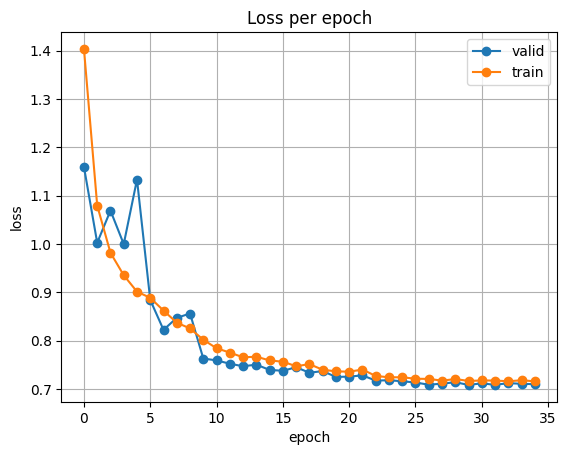

In [24]:
def plot_loss(history):
    plt.plot(history['valid_loss'], label='valid', marker='o')
    plt.plot( history['train_loss'], label='train', marker='o')
    plt.title('Loss per epoch')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend()
    plt.grid()
    plt.show()

plot_loss(mhist)

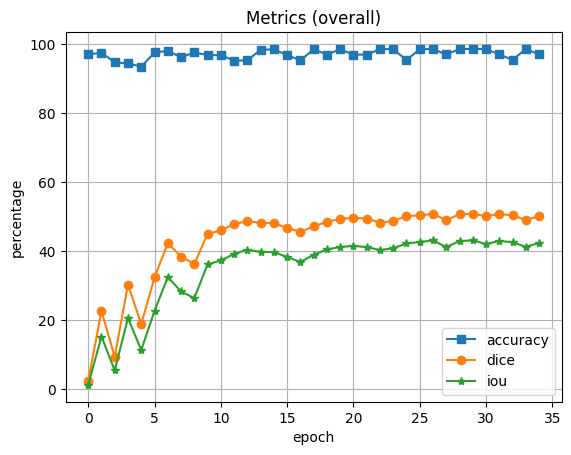

In [25]:
def plot_metrics(history):
    plt.plot(history['p_acc'], label='accuracy', marker='s')
    plt.plot(history['d_score']*100, label='dice', marker='o')
    plt.plot(history['iou'], label='iou', marker='*')
    plt.title('Metrics (overall)')
    plt.ylabel('percentage')
    plt.xlabel('epoch')
    plt.legend()
    plt.grid()
    plt.show()

plot_metrics(mhist)

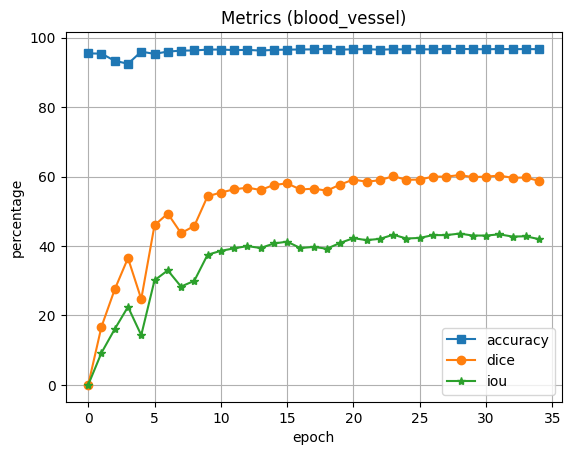

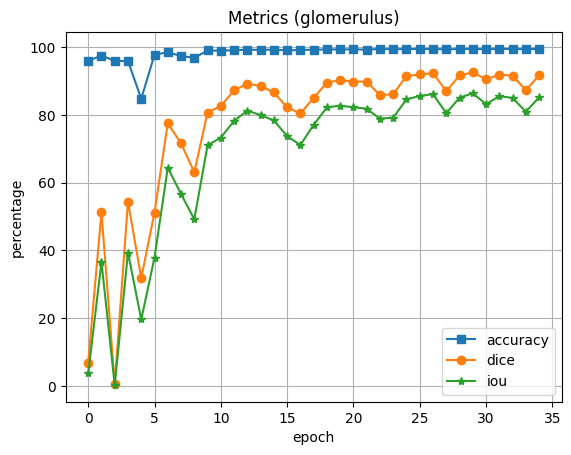

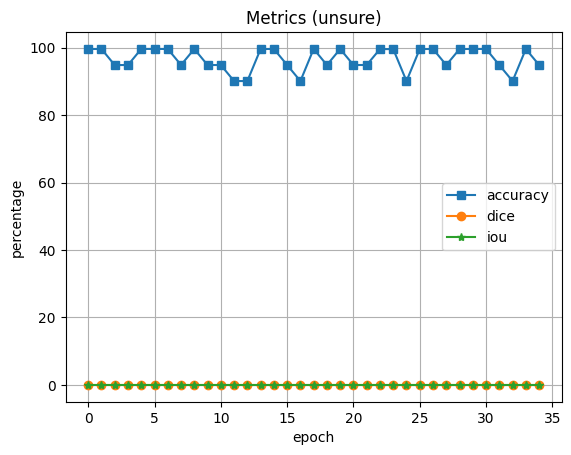

In [26]:
def plot_class_metrics(history, class_name="blood_vessel"):
    plt.plot(history['p_acc'], label='accuracy', marker='s')
    plt.plot(history['d_score']*100, label='dice', marker='o')
    plt.plot(history['iou'], label='iou', marker='*')
    plt.title(f'Metrics ({class_name})')
    plt.ylabel('percentage')
    plt.xlabel('epoch')
    plt.legend()
    plt.grid()
    plt.show()

plot_class_metrics(mhist_bl, class_name="blood_vessel")
plot_class_metrics(mhist_gl, class_name="glomerulus")
plot_class_metrics(mhist_us, class_name="unsure")

## Inference

In [27]:
def predict_on_batch(batch_of_data, eval_model, model_name=""):

    for img, lbl in zip(batch_of_data[0], batch_of_data[1]):
        img = img.to(device)
        lbl = lbl.to(device)
        img_to_pred = torch.unsqueeze(img, 0).to(torch.float32)

        pred_logits = eval_model(img_to_pred)
        pred_class = torch.argmax(pred_logits, axis=1).squeeze(0)
        
        ## Stats per class
        pixel_acc = {}
        dice = {}
        iou = {}
        
        for class_name, class_id in seg_class_idx.items():
            pred_mask = pred_class == class_id
            true_mask = lbl == class_id

            intersection = (pred_mask & true_mask).sum().item()
            union = (pred_mask | true_mask).sum().item()

            num_correct = (pred_mask == true_mask).sum().item()
            num_pixels = torch.numel(true_mask)

            if num_correct>0: # if some class is missing on the image
                pixel_acc[class_name] = num_correct / num_pixels * 100
                iou[class_name] = intersection / union * 100 if union > 0 else 0
                dice[class_name] = dice_score(pred_mask, true_mask)
            else:
                pixel_acc[class_name] = 0
                iou[class_name] = 0
                dice[class_name] = 0
 
        print("Metrics per class:")
        for class_name, acc in pixel_acc.items():
            print(f"- {class_name}: pixel accuracy: {acc:.2f}%, iou: {iou[class_name]:.2f}%, dice score: {dice[class_name]:.2f}")

        ## Overall stats
        num_correct = (pred_class == lbl).sum().item()
        num_pixels = torch.numel(lbl)
        intersection = (pred_class & lbl).sum().item()
        union = (pred_class | lbl).sum().item()
        pixel_acc_overall = num_correct / num_pixels * 100
        iou_overall = intersection / union * 100 if union > 0 else 0
        dice_score_overall = dice_score(pred_class, lbl)

        ## Visualize
        pred_class = pred_class.cpu().numpy().swapaxes(0, -1)
        image = img.cpu().numpy().swapaxes(0, -1)
        label = lbl.cpu().numpy().swapaxes(0, -1)
        print("Overall metrics:")
        print(f"- pixel accuracy: {pixel_acc_overall:.2f}%")
        print(f"- iou: {iou_overall:.2f}%")
        print(f"- dice score: {dice_score_overall:.2f}")

        fig, axs = plt.subplots(1, 3, figsize=(18, 10))
        axs[0].imshow(image)
        axs[0].set_title("Image")
        axs[1].imshow(image)
        axs[1].imshow(label, alpha=0.6)
        axs[1].set_title("Mask & image")
        axs[2].imshow(image)
        axs[2].imshow(pred_class, alpha=0.6)
        axs[2].set_title(f"{model_name} Predictions")
        plt.axis('on')
        plt.show()

Metrics per class:
- blood_vessel: pixel accuracy: 99.28%, iou: 19.76%, dice score: 0.40
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 99.28%
- iou: 19.76%
- dice score: 0.33


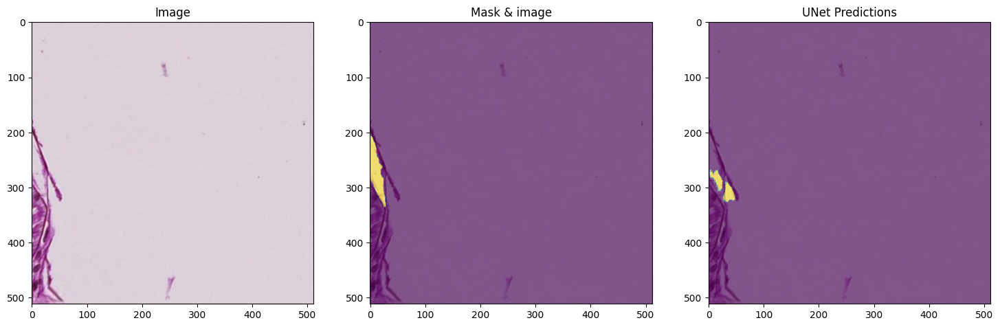

Metrics per class:
- blood_vessel: pixel accuracy: 94.16%, iou: 29.76%, dice score: 0.60
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 99.09%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 93.63%
- iou: 26.69%
- dice score: 0.53


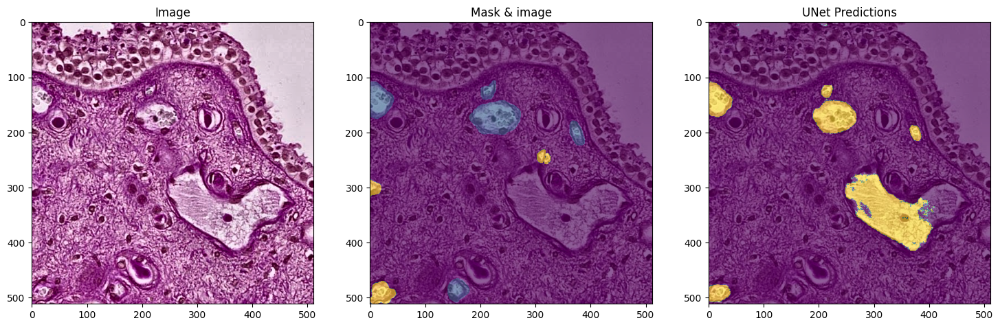

Metrics per class:
- blood_vessel: pixel accuracy: 98.63%, iou: 55.04%, dice score: 1.10
- glomerulus: pixel accuracy: 98.48%, iou: 90.40%, dice score: 1.81
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 97.11%
- iou: 87.29%
- dice score: 1.81


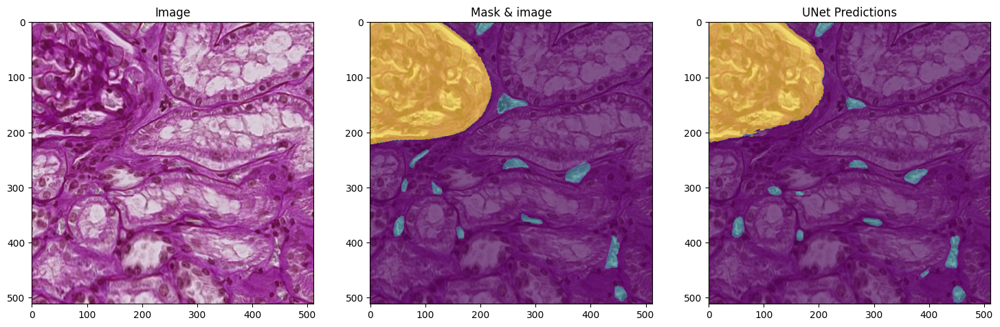

Metrics per class:
- blood_vessel: pixel accuracy: 99.54%, iou: 40.33%, dice score: 0.81
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 99.54%
- iou: 40.33%
- dice score: 0.57


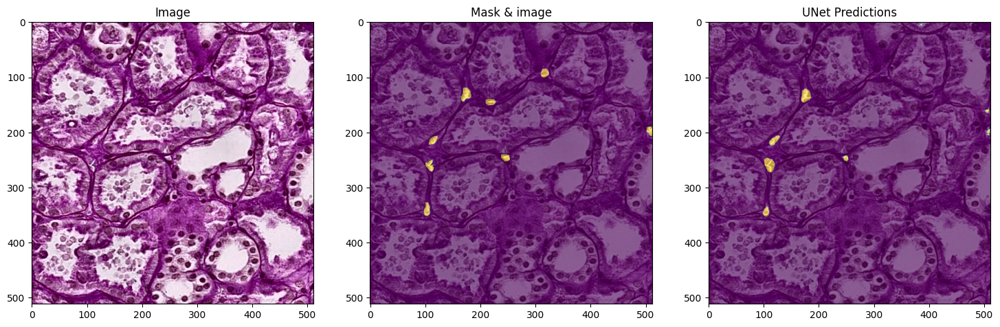

Metrics per class:
- blood_vessel: pixel accuracy: 99.24%, iou: 52.58%, dice score: 1.05
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 99.24%
- iou: 52.58%
- dice score: 0.69


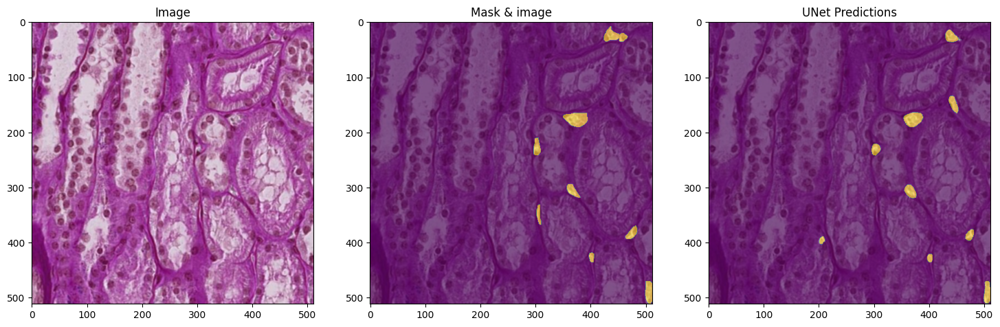

Metrics per class:
- blood_vessel: pixel accuracy: 97.39%, iou: 56.17%, dice score: 1.12
- glomerulus: pixel accuracy: 99.45%, iou: 97.46%, dice score: 1.95
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 96.85%
- iou: 92.42%
- dice score: 1.85


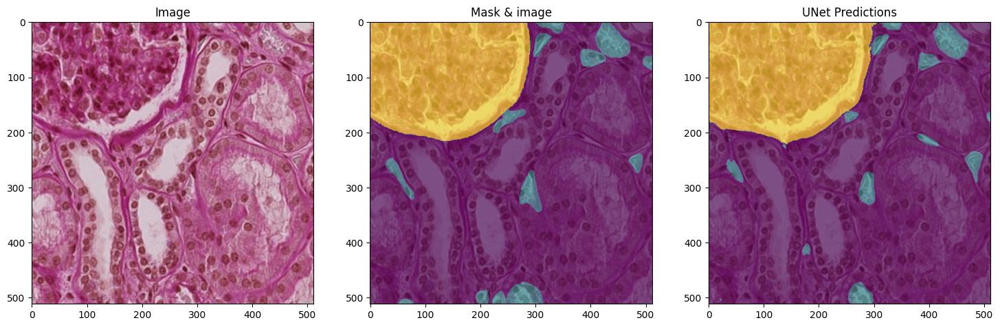

Metrics per class:
- blood_vessel: pixel accuracy: 94.65%, iou: 56.97%, dice score: 1.14
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 99.35%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 94.34%
- iou: 52.95%
- dice score: 0.76


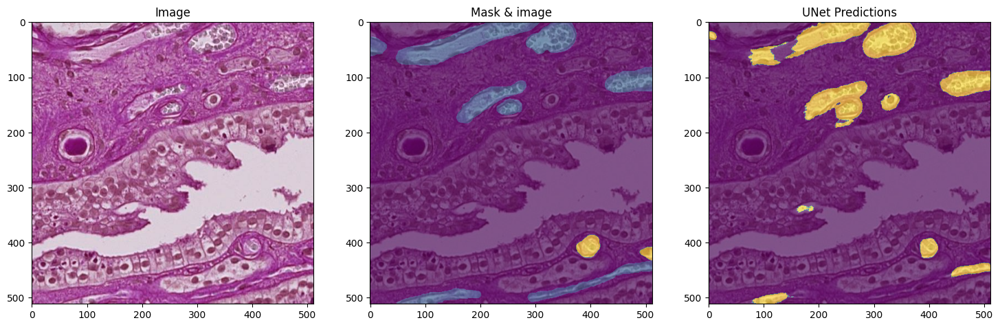

Metrics per class:
- blood_vessel: pixel accuracy: 99.79%, iou: 0.00%, dice score: 0.00
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 99.79%
- iou: 0.00%
- dice score: 0.00


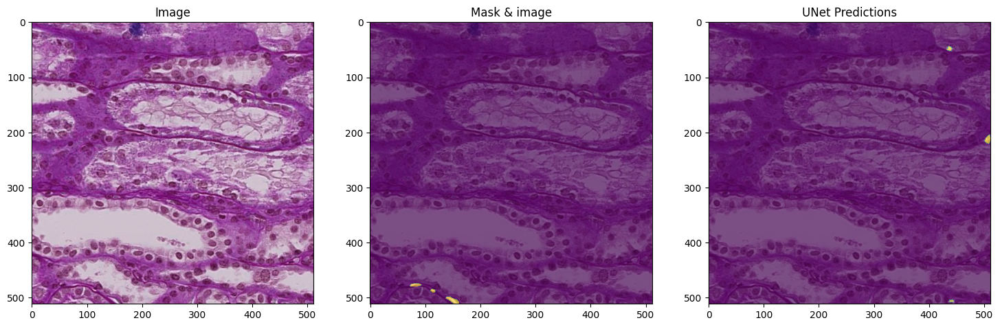

Metrics per class:
- blood_vessel: pixel accuracy: 99.43%, iou: 71.99%, dice score: 1.44
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 99.43%
- iou: 71.99%
- dice score: 0.84


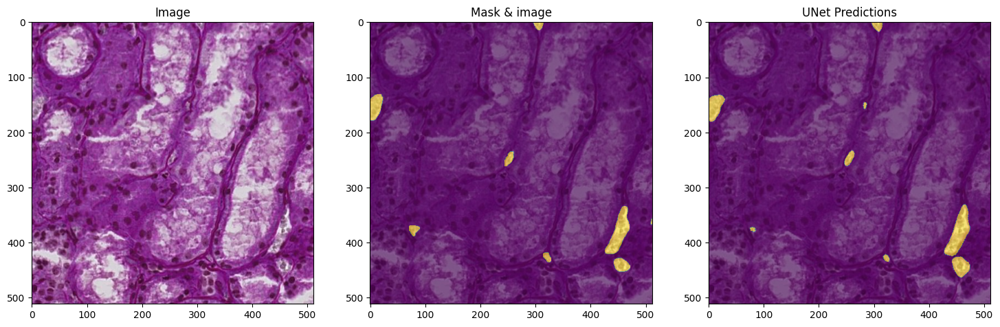

Metrics per class:
- blood_vessel: pixel accuracy: 99.66%, iou: 0.00%, dice score: 0.00
- glomerulus: pixel accuracy: 94.08%, iou: 20.84%, dice score: 0.42
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 93.75%
- iou: 20.38%
- dice score: 0.68


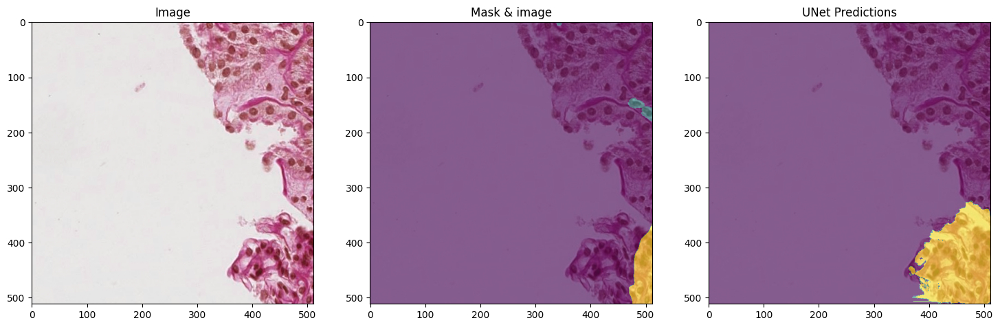

Metrics per class:
- blood_vessel: pixel accuracy: 99.77%, iou: 38.26%, dice score: 0.77
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 99.77%
- iou: 38.26%
- dice score: 0.55


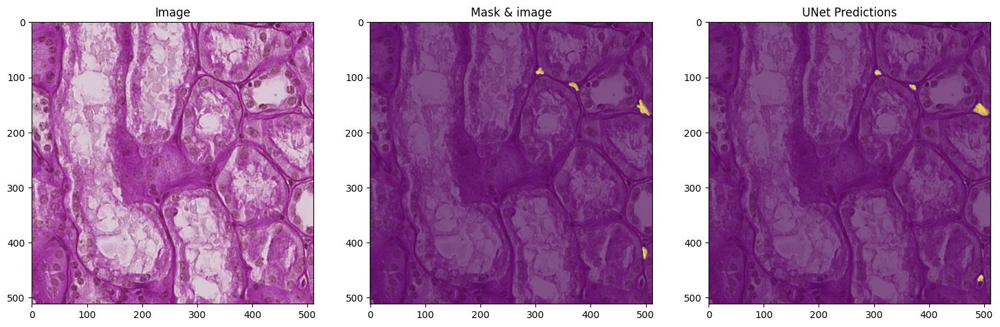

Metrics per class:
- blood_vessel: pixel accuracy: 90.14%, iou: 16.44%, dice score: 0.33
- glomerulus: pixel accuracy: 98.71%, iou: 88.67%, dice score: 1.77
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 88.85%
- iou: 63.99%
- dice score: 1.49


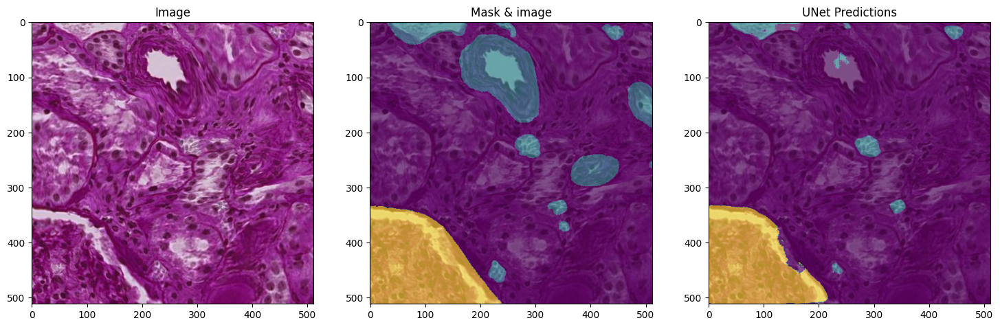

Metrics per class:
- blood_vessel: pixel accuracy: 98.79%, iou: 49.61%, dice score: 0.99
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 98.79%
- iou: 49.61%
- dice score: 0.66


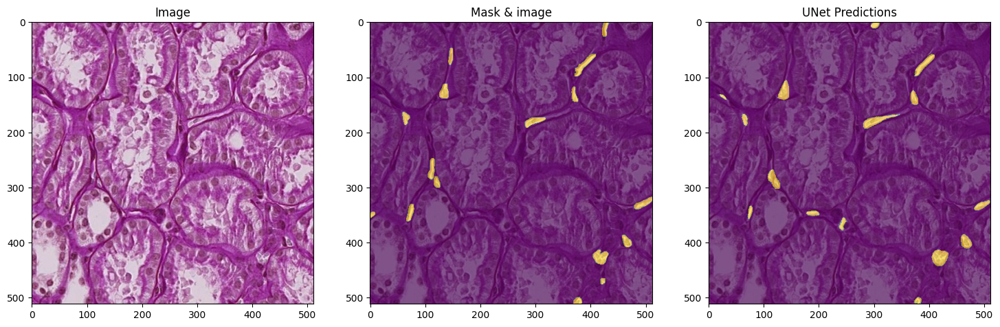

Metrics per class:
- blood_vessel: pixel accuracy: 96.11%, iou: 36.51%, dice score: 0.73
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 96.11%
- iou: 36.51%
- dice score: 0.53


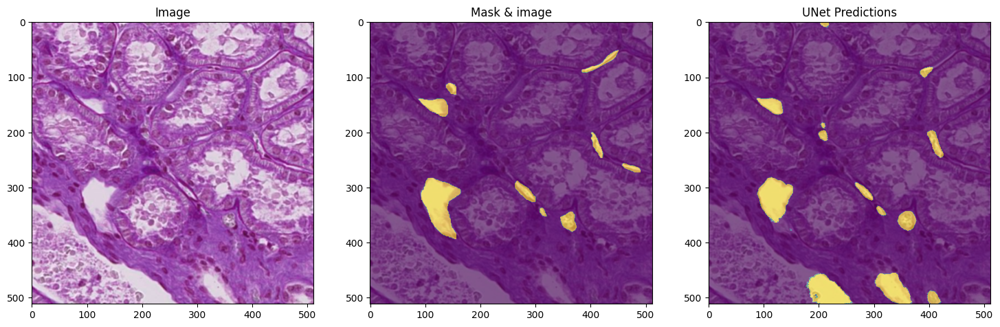

Metrics per class:
- blood_vessel: pixel accuracy: 97.22%, iou: 39.24%, dice score: 0.78
- glomerulus: pixel accuracy: 99.93%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 97.15%
- iou: 38.00%
- dice score: 0.55


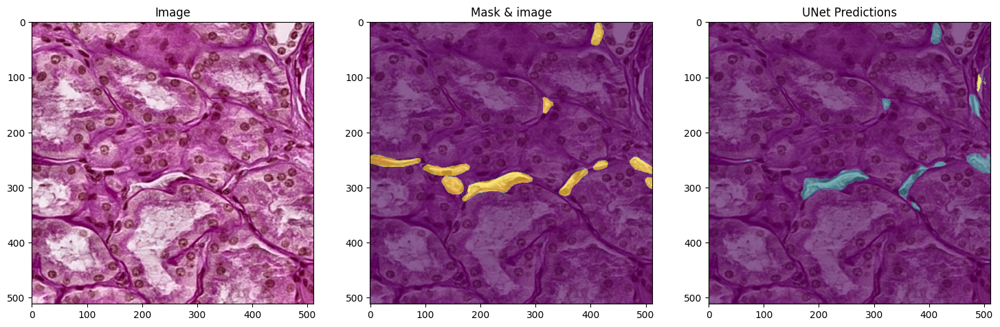

Metrics per class:
- blood_vessel: pixel accuracy: 96.45%, iou: 35.42%, dice score: 0.71
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 98.44%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 95.60%
- iou: 28.10%
- dice score: 0.67


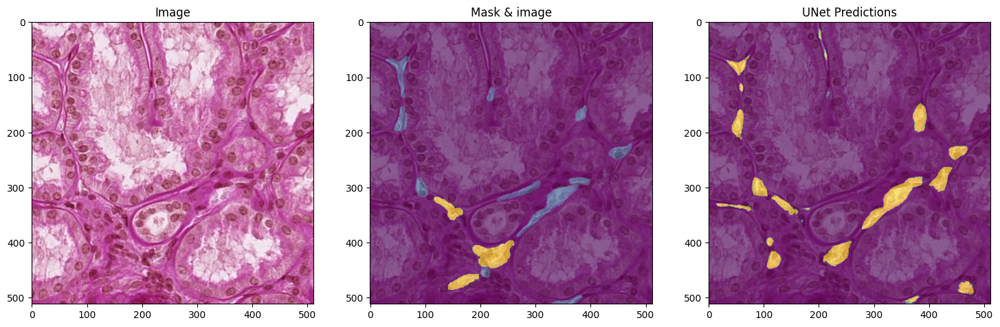

Metrics per class:
- blood_vessel: pixel accuracy: 99.61%, iou: 69.52%, dice score: 1.39
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 99.61%
- iou: 69.52%
- dice score: 0.82


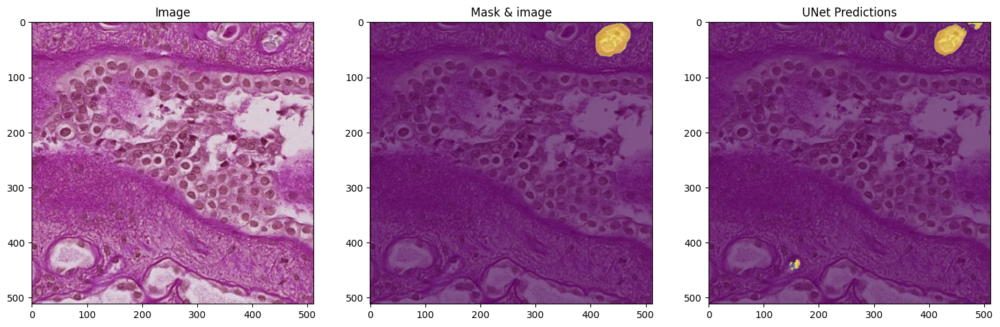

Metrics per class:
- blood_vessel: pixel accuracy: 89.92%, iou: 15.65%, dice score: 0.31
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 89.92%
- iou: 15.65%
- dice score: 0.27


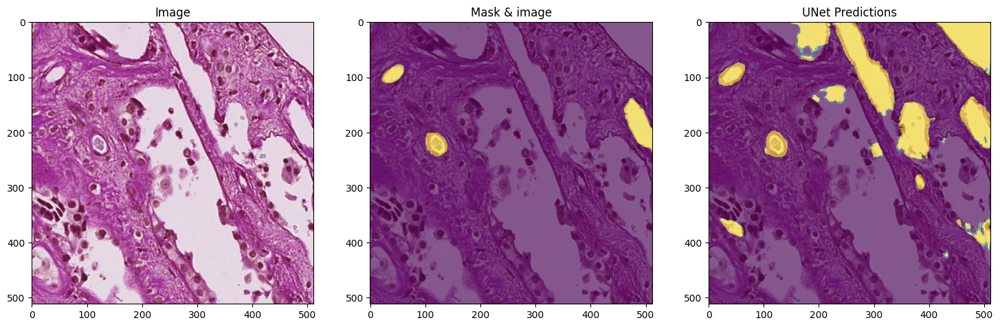

Metrics per class:
- blood_vessel: pixel accuracy: 97.25%, iou: 59.48%, dice score: 1.19
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 97.25%
- iou: 59.48%
- dice score: 0.75


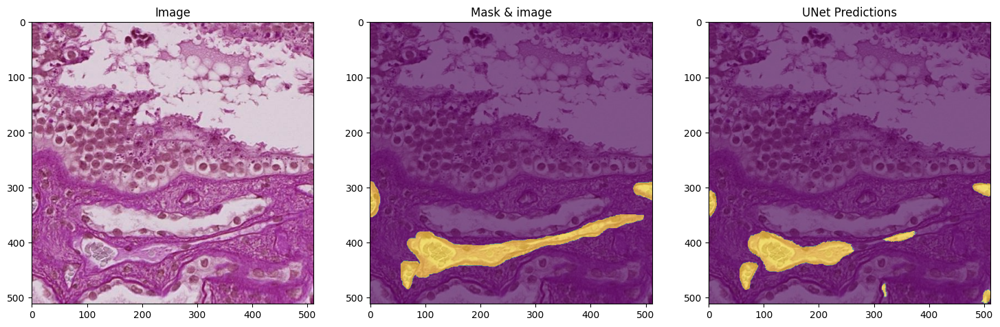

Metrics per class:
- blood_vessel: pixel accuracy: 98.30%, iou: 50.72%, dice score: 1.01
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 98.30%
- iou: 50.72%
- dice score: 0.67


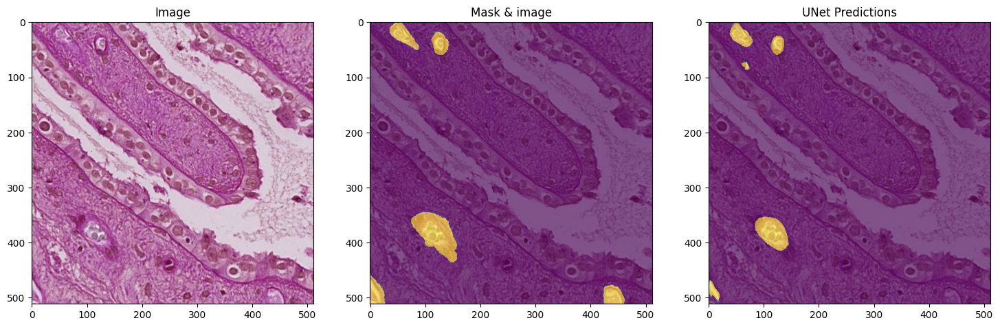

Metrics per class:
- blood_vessel: pixel accuracy: 99.52%, iou: 67.88%, dice score: 1.36
- glomerulus: pixel accuracy: 99.03%, iou: 93.71%, dice score: 1.87
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 98.56%
- iou: 92.52%
- dice score: 1.89


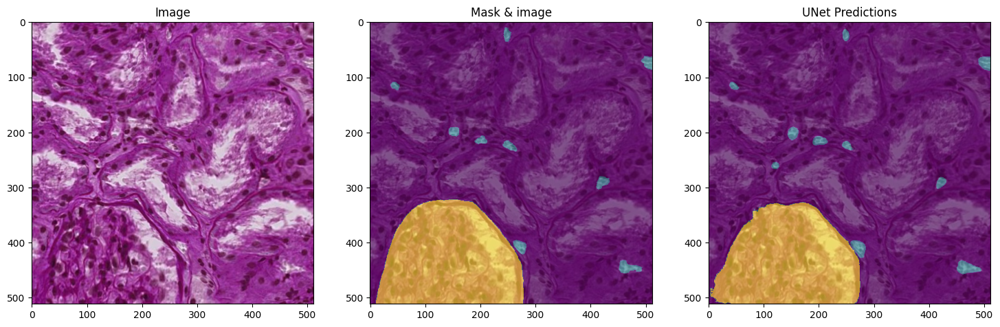

Metrics per class:
- blood_vessel: pixel accuracy: 97.80%, iou: 63.84%, dice score: 1.28
- glomerulus: pixel accuracy: 97.12%, iou: 85.50%, dice score: 1.71
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 95.37%
- iou: 82.63%
- dice score: 1.74


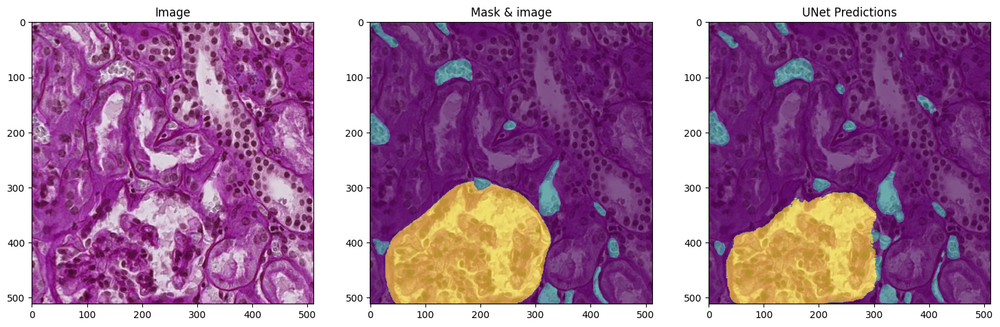

Metrics per class:
- blood_vessel: pixel accuracy: 98.47%, iou: 41.80%, dice score: 0.84
- glomerulus: pixel accuracy: 99.05%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 97.52%
- iou: 24.23%
- dice score: 0.39


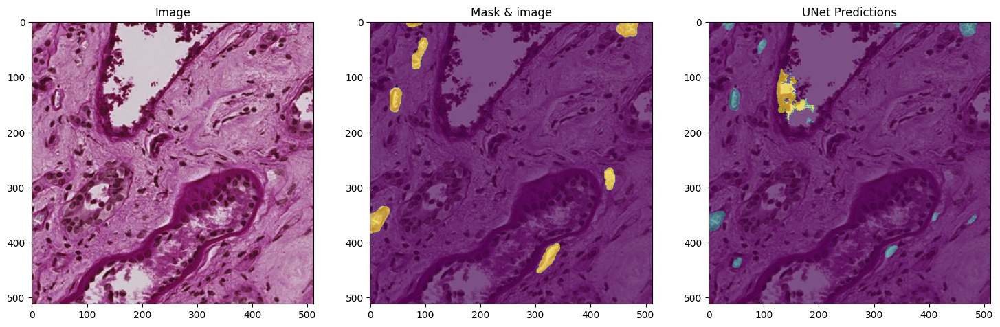

Metrics per class:
- blood_vessel: pixel accuracy: 97.90%, iou: 29.84%, dice score: 0.60
- glomerulus: pixel accuracy: 98.63%, iou: 70.42%, dice score: 1.41
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 96.54%
- iou: 60.51%
- dice score: 1.42


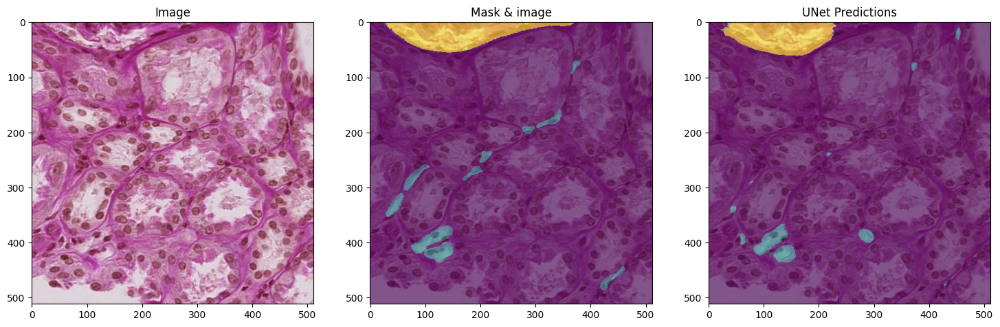

Metrics per class:
- blood_vessel: pixel accuracy: 97.07%, iou: 61.93%, dice score: 1.24
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 99.24%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 96.61%
- iou: 52.37%
- dice score: 0.77


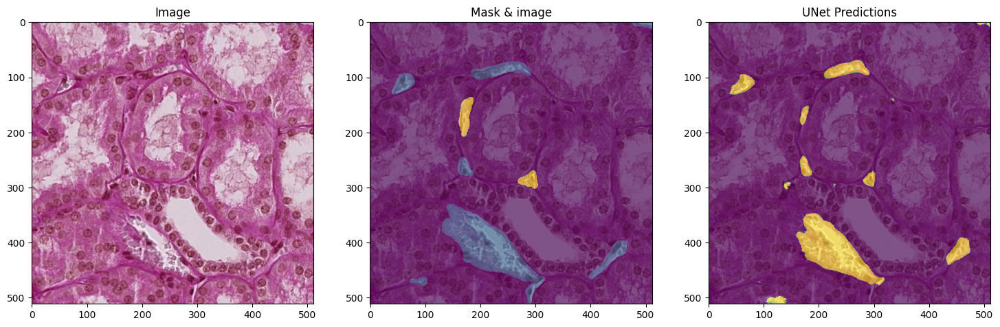

Metrics per class:
- blood_vessel: pixel accuracy: 96.33%, iou: 17.37%, dice score: 0.35
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 96.33%
- iou: 17.37%
- dice score: 0.30


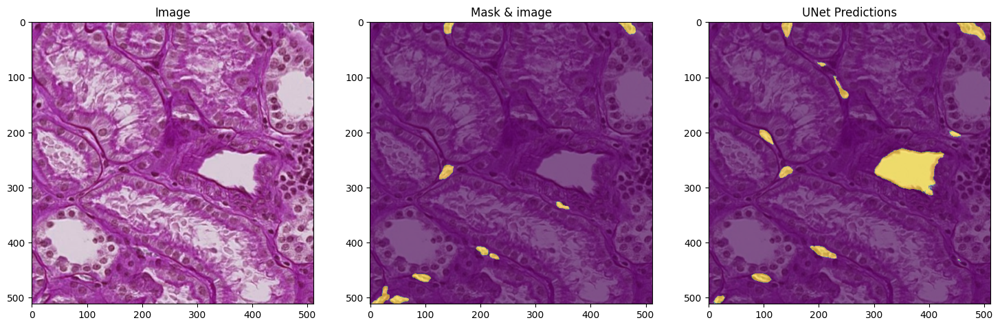

Metrics per class:
- blood_vessel: pixel accuracy: 99.46%, iou: 17.13%, dice score: 0.34
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 99.46%
- iou: 17.13%
- dice score: 0.29


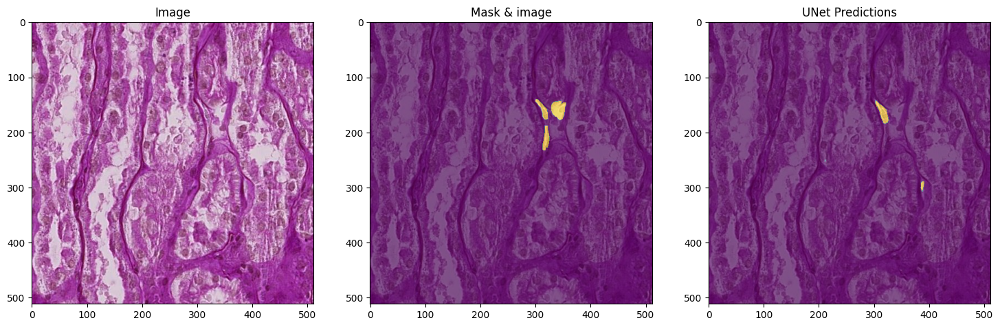

Metrics per class:
- blood_vessel: pixel accuracy: 97.55%, iou: 62.13%, dice score: 1.24
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 97.55%
- iou: 62.13%
- dice score: 0.77


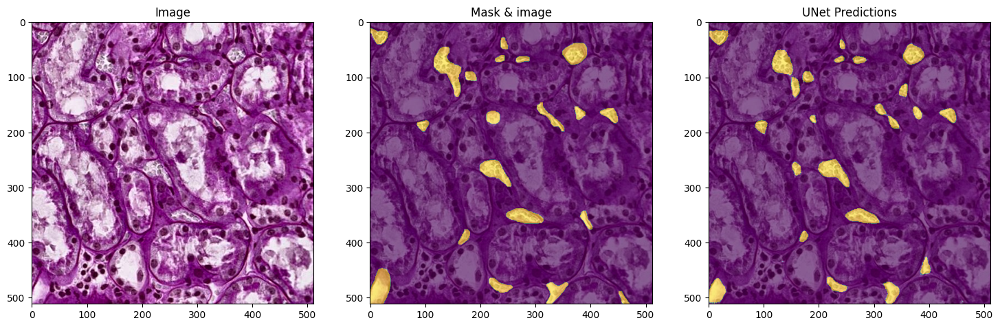

Metrics per class:
- blood_vessel: pixel accuracy: 97.69%, iou: 19.06%, dice score: 0.38
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 97.84%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 96.61%
- iou: 19.57%
- dice score: 0.76


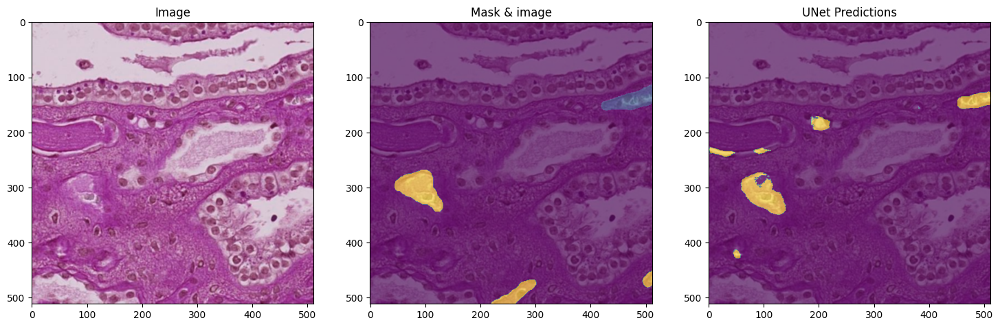

Metrics per class:
- blood_vessel: pixel accuracy: 98.83%, iou: 42.52%, dice score: 0.85
- glomerulus: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 98.83%
- iou: 42.52%
- dice score: 0.60


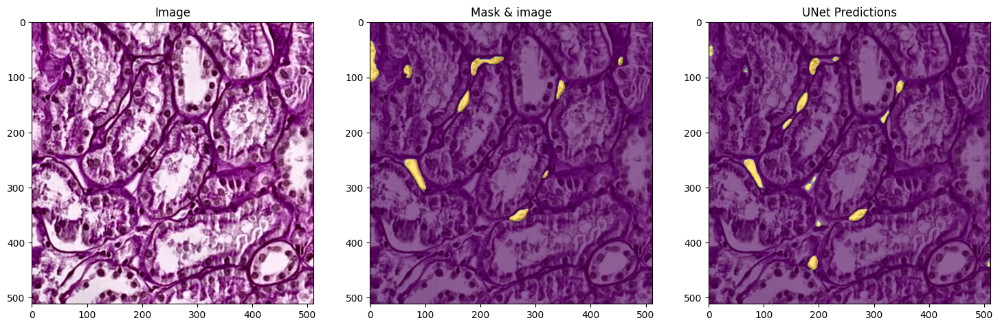

Metrics per class:
- blood_vessel: pixel accuracy: 95.58%, iou: 41.44%, dice score: 0.83
- glomerulus: pixel accuracy: 99.98%, iou: 0.00%, dice score: 0.00
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 95.55%
- iou: 41.17%
- dice score: 0.58


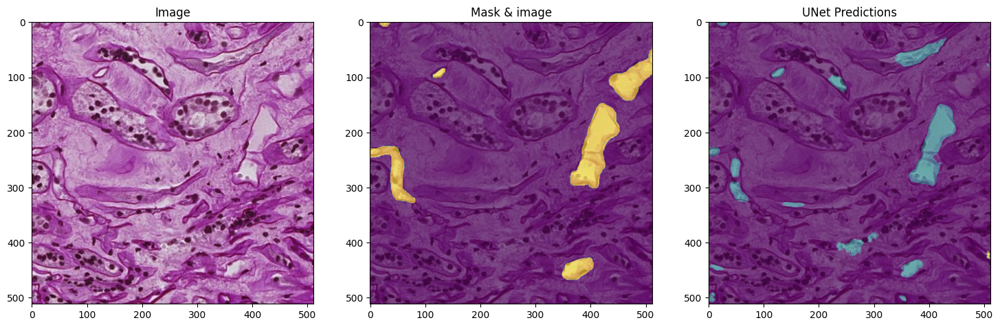

Metrics per class:
- blood_vessel: pixel accuracy: 98.66%, iou: 8.78%, dice score: 0.18
- glomerulus: pixel accuracy: 98.92%, iou: 91.99%, dice score: 1.84
- unsure: pixel accuracy: 100.00%, iou: 0.00%, dice score: 0.00
Overall metrics:
- pixel accuracy: 97.58%
- iou: 87.68%
- dice score: 1.86


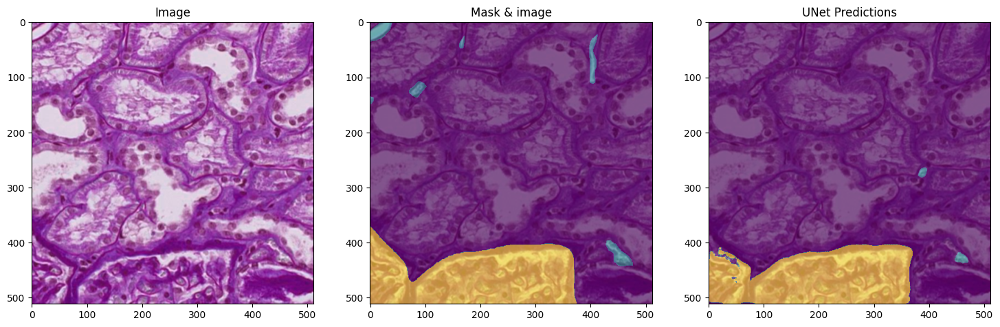

In [28]:
## Unet results
best_unet = "/kaggle/working/best_model_state.h5"
unet_inf_model = UNet(in_filters=cfg.filters, num_classes=cfg.num_classes)
unet_inf_model.load_state_dict(torch.load(best_unet))
unet_inf_model.eval().to(device)

# Predict on validation set
itera = iter(val_loader)
vbatch_1 = next(itera)
vbatch_2 = next(itera)
predict_on_batch(vbatch_1, unet_inf_model, model_name="UNet")
predict_on_batch(vbatch_2, unet_inf_model, model_name="UNet")

## Submission

try submission from: https://www.kaggle.com/code/ermak9/sample-submission

https://www.kaggle.com/code/saworz/hubmap-how-to-make-first-dummy-submission

In [36]:
## Look at my other notebook if you don't know how to install pycocotools
!pip install pycocotools==2.0.6

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pycocotools: filename=pycocotools-2.0.6-cp310-cp310-linux_x86_64.whl size=109338 sha256=fd25001865877f0696506e0e0b40bf33d6d42ce18c2f3bd9305d7401347b7ce6
  Stored in directory: /root/.cache/pip/wheels/58/e6/f9/f87c8f8be098b51b616871315318329cae12cdb618f4caac93
Successfully built pycocotools


In [39]:
import base64
import numpy as np
from pycocotools import _mask as coco_mask
import typing as t
import zlib
import os
import cv2
import matplotlib.pyplot as plt
import pandas as pd

## Function from https://www.kaggle.com/competitions/hubmap-hacking-the-human-vasculature/overview/evaluation

def encode_binary_mask(mask: np.ndarray) -> t.Text:
    """Converts a binary mask into OID challenge encoding ascii text."""

    # check input mask --
    if mask.dtype != bool:
        raise ValueError(
            "encode_binary_mask expects a binary mask, received dtype == %s" %
            mask.dtype)

    mask = np.squeeze(mask)
    if len(mask.shape) != 2:
        raise ValueError(
            "encode_binary_mask expects a 2d mask, received shape == %s" %
            mask.shape)

    # convert input mask to expected COCO API input --
    mask_to_encode = mask.reshape(mask.shape[0], mask.shape[1], 1)
    mask_to_encode = mask_to_encode.astype(np.uint8)
    mask_to_encode = np.asfortranarray(mask_to_encode)

    # RLE encode mask --
    encoded_mask = coco_mask.encode(mask_to_encode)[0]["counts"]

    # compress and base64 encoding --
    binary_str = zlib.compress(encoded_mask, zlib.Z_BEST_COMPRESSION)
    base64_str = base64.b64encode(binary_str)
    return base64_str

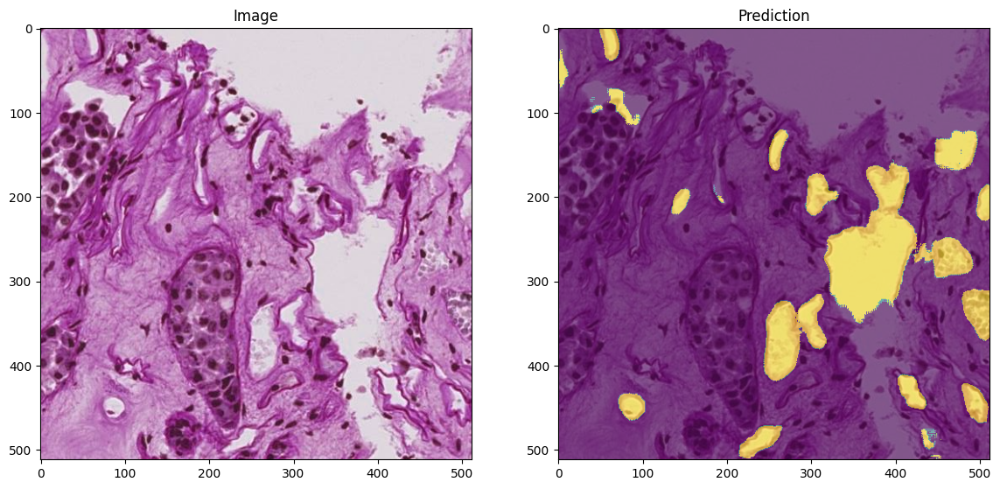

In [45]:
def test_predict(img_path, eval_model):
    image = cv2.imread(img_path, cv2.COLOR_BGR2RGB)
    image = np.array(image) / 255.0
    image = torch.tensor(image, dtype=torch.float32).permute(2, 0, 1).to(device)
    
    img_to_pred = torch.unsqueeze(image, 0)
    pred_logits = eval_model(img_to_pred)
    pred_class = torch.argmax(pred_logits, axis=1).squeeze(0)

    ## Visualize
    pred_class = pred_class.cpu().numpy().swapaxes(0, -1)
    image = image.cpu().numpy().swapaxes(0, -1)

    fig, axs = plt.subplots(1, 2, figsize=(14, 10))
    axs[0].imshow(image)
    axs[0].set_title("Image")
    axs[1].imshow(image)
    axs[1].imshow(pred_class, alpha=0.6)
    axs[1].set_title("Prediction")
    plt.axis('on')
    plt.show()

    return pred_class

test_im_path = "/kaggle/input/hubmap-hacking-the-human-vasculature/test/72e40acccadf.tif"
pred_mask = test_predict(img_path=test_im_path, eval_model=unet_inf_model)

In [46]:
pred_mask.shape

(512, 512)

In [49]:

test_path = "/kaggle/input/hubmap-hacking-the-human-vasculature/test"
sample_submission = pd.read_csv('/kaggle/input/hubmap-hacking-the-human-vasculature/sample_submission.csv')

ids = []
heights = []
widths = []
prediction_strings = []
for img_name in os.listdir(test_path):
    img = cv2.imread(f"{test_path}/{img_name}", 0)
    h, w = img.shape
    
#     mask = np.ones((h, w), dtype=np.bool)
    mask = pred_mask.astype("bool")
    encoded = encode_binary_mask(mask)
    
    ids.append(img_name.split('.')[0])
    heights.append(h)
    widths.append(w)
    prediction_strings.append(f"0 1.0 {encoded.decode('utf-8')}")

submission = pd.DataFrame()
submission['id'] = ids
submission['height'] = heights
submission['width'] = widths
submission['prediction_string'] = prediction_strings

submission = submission.set_index('id')
print(submission)
submission.to_csv("submission.csv")

              height  width  \
id                            
72e40acccadf     512    512   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          